# Trabalho de conclusão de disciplina

Importando a base escolhida, e as bibliotecas para a exploração de dados. A base escolhida foi a de microdados do enem, A base original se encontra no site do MEC. A base foi encontrada no servidor de dados do Curso de Ciência de dados e Inteligência Artificial, está base já foi pré-selecionada e limpado os dados.

In [1]:
import pandas as pd #Importando pandas
import matplotlib.pyplot as plt #Importando matplotlib.pyplot
import numpy as np  #Importando numpy
import seaborn as sns  #Importando seaborn

In [2]:
df = pd.read_excel(r'C:\Users\felip\Downloads\ENEM_2020.xlsx') # leitura do arquivo excel e armazenando em um dataframe

## Funções utilizadas no notebook 

In [81]:
def contar_qtd_idade_sexo(df, sexo):
    sex_count = df[df['TP_SEXO'] == sexo]['TP_FAIXA_ETARIA'].value_counts()
    return sex_count

def separar_regiao(df, filtro):
    regiao = df.where(filtro)
    regiao.dropna(inplace=True)
    return regiao

def fazer_notas(df):
    notas = pd.Series(data={'Nota_CH':df.NOTA_CH_CIENCIAS_hUMANAS.mean(), 
                            'Nota_CN':df.NOTA_CN_CIENCIAS_DA_NATUREZA.mean(), 
                            'Nota_LC':df.NOTA_LC_LINGUAGENS_E_CODIGOS.mean(), 
                            'Nota_MT':df.NOTA_MT_MATEMATICA.mean(),
                            'Nota_RE':df.NOTA_REDACAO.mean()})
    return notas

def fazer_boxplot(df, coluna):
    fig, ax = plt.subplots(figsize=(10, 10))
    sns.boxplot(x=df.Região, y=df[coluna], hue=df.Região, data=df, width=0.6, dodge=False)
    ax.grid(True)
    return ax
    
def graficos_padrao(df):
    sns.set_style("whitegrid")
    fig, ax = plt.subplots(2, 3, figsize=(20,12), squeeze = False, layout= 'constrained')

    notas = fazer_notas(df)
    ax[0][0].scatter(x=notas.index, y=notas.values,  c=["#20257c", "#424ad1", "#6a8ee8", "#66bbe2", "#66dee2"])
    ax[0][0].set_title('Média das notas')
    ax[0][0].grid(True, axis='y')

    barra = ax[0][1].bar(["Masculino", 'Feminino'], height=df.TP_SEXO.value_counts(), width=0.3, color=["#1c74b4", '#fc7c0c'])
    ax[0][1].bar_label(barra)
    ax[0][1].set_title('Distribuição de sexo')
    ax[0][1].grid(True, axis='y')

    ax[0][2] = sns.countplot(data=df, order = df.TP_COR_RACA.value_counts().index, x='TP_COR_RACA', ax=ax[0][2])
    ax[0][2].bar_label(ax[0][2].containers[0])
    ax[0][2].set_title('Distribuição da idade')
    plt.setp(ax[0][2].get_xticklabels(), rotation=18, ha="right")
    ax[0][2].grid(True, axis='y')

    ax[1][0].boxplot(df.NOTA_MEDIA_5_NOTAS, 1, 'gD')
    ax[1][0].set_title('Distribuição das médias')
    ax[1][0].grid(True)

    men_means= contar_qtd_idade_sexo(df, 'Masculino')
    women_means = contar_qtd_idade_sexo(df, 'Feminino') 
    labels = df.TP_FAIXA_ETARIA.value_counts().index

    ax[1][1].bar(labels, men_means, width=0.35, label='Homem')
    ax[1][1].bar(labels, women_means, width=0.35, bottom=men_means, label='Mulher')
    ax[1][1].legend()
    plt.setp(ax[1][1].get_xticklabels(), rotation=18, ha="right")
    ax[1][1].grid(True)
    ax[1][1].set_title('Distriubuição de sexo por idades')

    barra2 = ax[1][2].bar(df.SG_UF_PROVA.value_counts().index, df.SG_UF_PROVA.value_counts(), width=0.35)
    ax[1][2].bar_label(barra2)
    ax[1][2].set_title('Distribuição dos indivíduos por estado')
    ax[1][2].grid(True)

def distribuir_notas(df, x_size):
    fig, ax = plt.subplots(figsize=(x_size, 10))
    sns.boxplot(x='SG_UF_PROVA', y='NOTA_MEDIA_5_NOTAS', data=df)
    ax.set_title('Distribuição das médias por estado na região')
    ax.grid(True)

##  Verificando o tamanho e os tipos de dados

In [4]:
df.shape #Tamanho do Dataframe

(219370, 33)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219370 entries, 0 to 219369
Data columns (total 33 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   NU_ANO                        219370 non-null  int64  
 1   CO_UF_PROVA                   219370 non-null  int64  
 2   SG_UF_PROVA                   219370 non-null  object 
 3   CO_MUNICIPIO_PROVA            219370 non-null  int64  
 4   NO_MUNICIPIO_PROVA            219370 non-null  object 
 5   TP_FAIXA_ETARIA               219370 non-null  object 
 6   TP_SEXO                       219370 non-null  object 
 7   TP_ESTADO_CIVIL               219370 non-null  object 
 8   TP_COR_RACA                   219370 non-null  object 
 9   TP_NACIONALIDADE              219370 non-null  object 
 10  TP_ST_CONCLUSAO               219370 non-null  object 
 11  TP_ANO_CONCLUIU               219370 non-null  object 
 12  TP_ESCOLA                     219370 non-nul

In [6]:
df.dtypes #Tipos dos dados de cada coluna

NU_ANO                            int64
CO_UF_PROVA                       int64
SG_UF_PROVA                      object
CO_MUNICIPIO_PROVA                int64
NO_MUNICIPIO_PROVA               object
TP_FAIXA_ETARIA                  object
TP_SEXO                          object
TP_ESTADO_CIVIL                  object
TP_COR_RACA                      object
TP_NACIONALIDADE                 object
TP_ST_CONCLUSAO                  object
TP_ANO_CONCLUIU                  object
TP_ESCOLA                        object
TP_ENSINO                        object
TP_DEPENDENCIA_ADM_ESC           object
TP_LOCALIZACAO_ESC               object
TP_SIT_FUNC_ESC                  object
NOTA_CN_CIENCIAS_DA_NATUREZA    float64
NOTA_CH_CIENCIAS_hUMANAS        float64
NOTA_LC_LINGUAGENS_E_CODIGOS    float64
NOTA_MT_MATEMATICA              float64
NOTA_REDACAO                      int64
NOTA_MEDIA_5_NOTAS              float64
TP_STATUS_REDACAO                object
Q001                             object


In [7]:
df.head() #Mostrar o topo da tabela

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,TP_STATUS_REDACAO,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025
0,2020,11,RO,1100015,Alta Floresta D'Oeste,23 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Sem problemas,Não completou a 4ª série/5º ano do ensino fund...,Não completou a 4ª série/5º ano do ensino fund...,"Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 1: Lavradora, agricultora sem empregados...",4.0,"Até R$ 1.045,00",Não,Não,Sim
1,2020,11,RO,1100015,Alta Floresta D'Oeste,17 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Sem problemas,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a Faculdade, mas não completou a Pós...","Grupo 3: Padeiro, cozinheiro industrial ou em ...",Grupo 4: Professora (de ensino fundamental ou ...,3.0,"De R$ 2.612,51 até R$ 3.135,00",Sim,"Sim, um",Sim
2,2020,11,RO,1100015,Alta Floresta D'Oeste,19 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Sem problemas,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a 4ª série/5º ano, mas não completou...",Grupo 4: Professor (de ensino fundamental ou m...,"Grupo 2: Diarista, empregada doméstica, cuidad...",3.0,"De R$ 2.612,51 até R$ 3.135,00",Não,"Sim, um",Sim
3,2020,11,RO,1100015,Alta Floresta D'Oeste,19 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Sem problemas,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a Faculdade, mas não completou a Pós...","Grupo 2: Diarista, empregado doméstico, cuidad...",Grupo 4: Professora (de ensino fundamental ou ...,5.0,"De R$ 1.567,51 até R$ 2.090,00",Não,Não,Sim
4,2020,11,RO,1100015,Alta Floresta D'Oeste,Menor de 17 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Sem problemas,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a 4ª série/5º ano, mas não completou...","Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 2: Diarista, empregada doméstica, cuidad...",5.0,"De R$ 1.567,51 até R$ 2.090,00",Não,"Sim, um",Sim


In [8]:
df.tail()

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,TP_STATUS_REDACAO,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025
219365,2020,53,DF,5300108,Brasília,23 anos,Feminino,Não informado,Parda,Brasileiro(a),...,Sem problemas,"Completou a 4ª série/5º ano, mas não completou...","Completou a 4ª série/5º ano, mas não completou...","Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 2: Diarista, empregada doméstica, cuidad...",1.0,"Até R$ 1.045,00",Não,Não,Não
219366,2020,53,DF,5300108,Brasília,Menor de 17 anos,Feminino,Solteiro(a),Preta,Brasileiro(a),...,Sem problemas,Não completou a 4ª série/5º ano do ensino fund...,Completou a 8ª série/9º ano do ensino fundamen...,"Grupo 3: Padeiro, cozinheiro industrial ou em ...",Não Sei,4.0,"De R$ 1.045,01 até R$ 1.567,50",Sim,"Sim, um",Sim
219367,2020,53,DF,5300108,Brasília,18 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Sem problemas,"Completou a Faculdade, mas não completou a Pós...","Completou a Faculdade, mas não completou a Pós...",Grupo 4: Professor (de ensino fundamental ou m...,Grupo 4: Professora (de ensino fundamental ou ...,5.0,"De R$ 7.315,01 até R$ 8.360,00",Sim,"Sim, dois",Sim
219368,2020,53,DF,5300108,Brasília,24 anos,Feminino,Solteiro(a),Branca,Brasileiro(a),...,Sem problemas,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ...",Grupo 4: Professor (de ensino fundamental ou m...,"Grupo 1: Lavradora, agricultora sem empregados...",5.0,"Até R$ 1.045,00",Não,"Sim, um",Sim
219369,2020,53,DF,5300108,Brasília,Menor de 17 anos,Feminino,Casado(a)/Mora com um(a) companheiro(a),Parda,Brasileiro(a),...,Sem problemas,Nunca estudou,Nunca estudou,"Grupo 1: Lavrador, agricultor sem empregados, ...","Grupo 1: Lavradora, agricultora sem empregados...",4.0,"De R$ 1.567,51 até R$ 2.090,00",Não,Não,Sim


In [9]:
print(df.columns.values)

['NU_ANO' 'CO_UF_PROVA' 'SG_UF_PROVA' 'CO_MUNICIPIO_PROVA'
 'NO_MUNICIPIO_PROVA' 'TP_FAIXA_ETARIA' 'TP_SEXO' 'TP_ESTADO_CIVIL'
 'TP_COR_RACA' 'TP_NACIONALIDADE' 'TP_ST_CONCLUSAO' 'TP_ANO_CONCLUIU'
 'TP_ESCOLA' 'TP_ENSINO' 'TP_DEPENDENCIA_ADM_ESC' 'TP_LOCALIZACAO_ESC'
 'TP_SIT_FUNC_ESC' 'NOTA_CN_CIENCIAS_DA_NATUREZA'
 'NOTA_CH_CIENCIAS_hUMANAS' 'NOTA_LC_LINGUAGENS_E_CODIGOS'
 'NOTA_MT_MATEMATICA' 'NOTA_REDACAO' 'NOTA_MEDIA_5_NOTAS'
 'TP_STATUS_REDACAO' 'Q001' 'Q002' 'Q003' 'Q004' 'Q005' 'Q006' 'Q023'
 'Q024' 'Q025']


In [10]:
df.drop(['NU_ANO', 'CO_UF_PROVA', 'CO_MUNICIPIO_PROVA'], axis=1).describe()

,NOTA_CN_CIENCIAS_DA_NATUREZA,NOTA_CH_CIENCIAS_hUMANAS,NOTA_LC_LINGUAGENS_E_CODIGOS,NOTA_MT_MATEMATICA,NOTA_REDACAO,NOTA_MEDIA_5_NOTAS,Q005
count,219370.000000,219370.000000,219370.000000,219370.000000,219370.000000,219370.000000,216732.000000
mean,492.108222,516.003812,527.108281,520.989246,592.518758,529.745664,3.768737
std,80.340258,95.318776,72.420818,117.859757,178.058128,89.088993,1.421095
min,0.000000,0.000000,0.000000,0.000000,40.000000,192.520000,1.000000
25%,428.400000,440.000000,481.400000,425.900000,480.000000,462.100000,3.000000
50%,485.100000,516.900000,532.300000,504.400000,580.000000,517.540000,4.000000
75%,550.200000,585.200000,578.500000,602.400000,720.000000,587.580000,4.000000
max,813.500000,862.600000,778.900000,975.000000,1000.000000,846.800000,20.000000


## Explorando as coluna de tipos('TP_...')

<AxesSubplot:xlabel='TP_FAIXA_ETARIA', ylabel='count'>

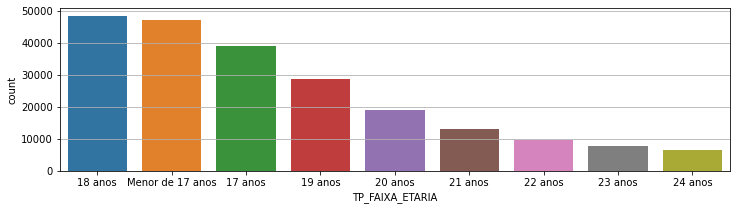

In [11]:
fig, ax = plt.subplots(figsize=(12,3)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_FAIXA_ETARIA'], order=df['TP_FAIXA_ETARIA'].value_counts().index) #Gráfico em barra das idades

In [12]:
df['TP_SEXO'].value_counts()  #Contando quantos valores na coluna TP_SEXO

Feminino     131640
Masculino     87730
Name: TP_SEXO, dtype: int64

Text(0.5, 0, 'Gêneros')

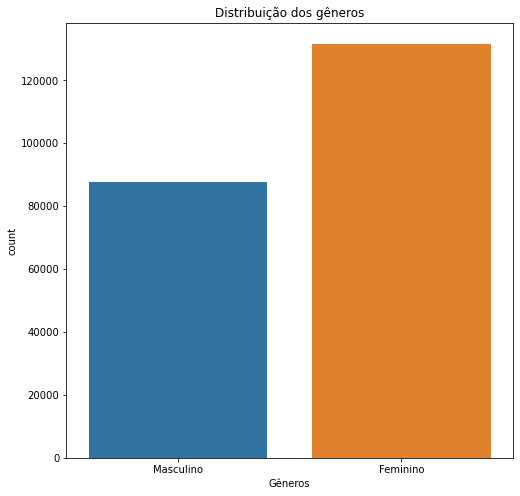

In [13]:
fig, ax = plt.subplots(figsize=(8, 8)) # Criando os objetos para trabalhar com os graficos

sns.countplot(x=df['TP_SEXO']) #Gráfico em barra da divisão de gênero

ax.set_title('Distribuição dos gêneros')
ax.set_xlabel('Gêneros')


<AxesSubplot:xlabel='TP_FAIXA_ETARIA', ylabel='count'>

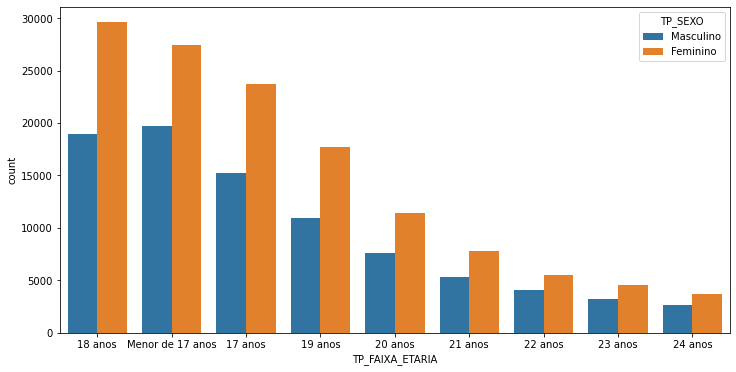

In [14]:
fig, ax = plt.subplots(figsize=(12,6))
sns.countplot(x='TP_FAIXA_ETARIA', hue='TP_SEXO', data=df, order=df['TP_FAIXA_ETARIA'].value_counts().index)

Text(0, 0.5, 'Contagem em logaritimo')

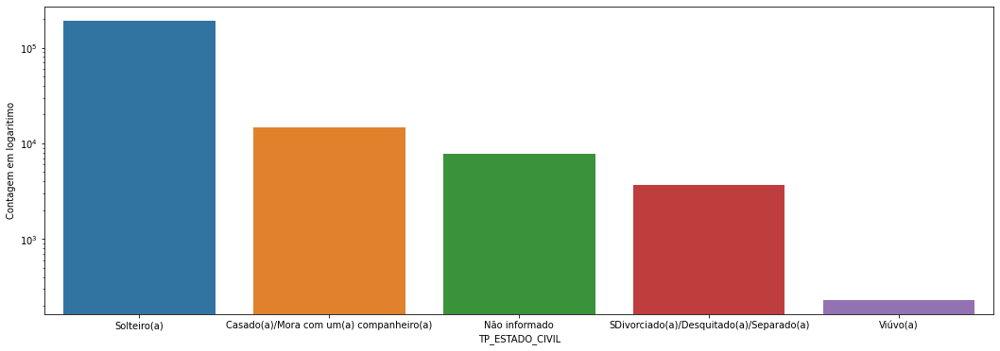

In [15]:
fig, ax = plt.subplots(figsize=(18,6))
sns.countplot(x='TP_ESTADO_CIVIL', data=df, order=df['TP_ESTADO_CIVIL'].value_counts().index, ax=ax, log=True)
ax.set_ylabel('Contagem em logaritimo')

Text(0, 0.5, 'Contagem em logaritimo')

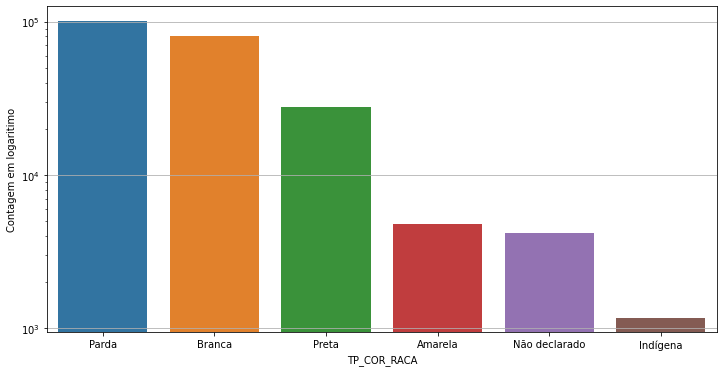

In [16]:
fig, ax = plt.subplots(figsize=(12,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_COR_RACA'], order=df['TP_COR_RACA'].value_counts().index, log=True) #Gráfico em barra das idades
ax.set_ylabel('Contagem em logaritimo')

Text(0, 0.5, 'Contagem em logaritimo')

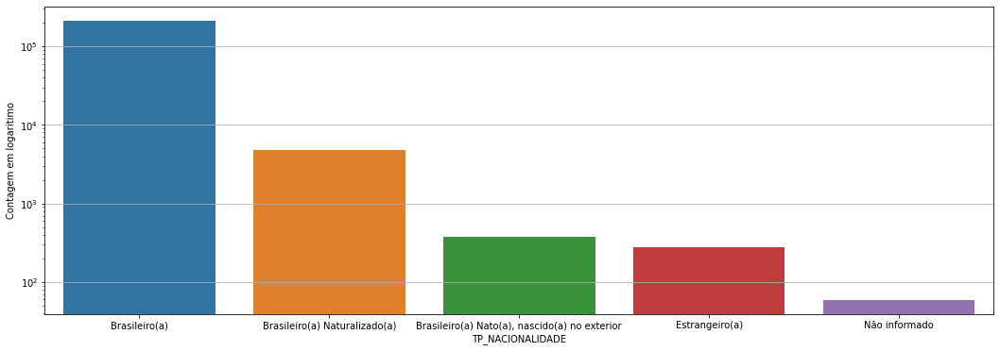

In [17]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_NACIONALIDADE'], order=df['TP_NACIONALIDADE'].value_counts().index,log=True)
ax.set_ylabel('Contagem em logaritimo')

Text(0, 0.5, 'Contagem em logaritimo')

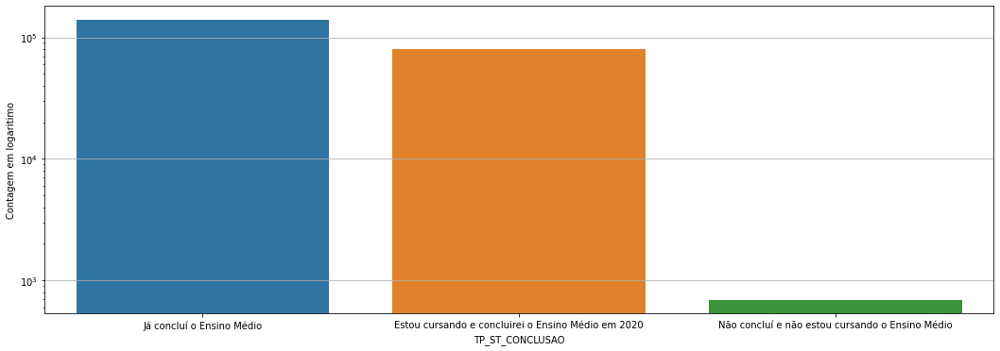

In [18]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_ST_CONCLUSAO'], order=df['TP_ST_CONCLUSAO'].value_counts().index,log=True)
ax.set_ylabel('Contagem em logaritimo')

<AxesSubplot:xlabel='TP_ANO_CONCLUIU', ylabel='count'>

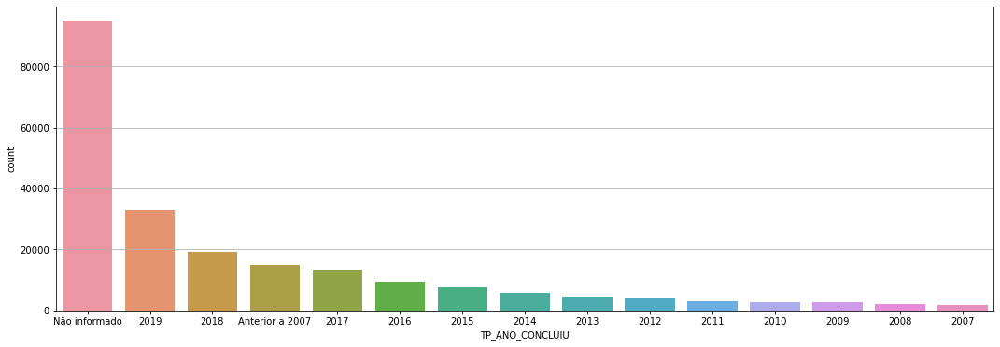

In [19]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_ANO_CONCLUIU'], order=df['TP_ANO_CONCLUIU'].value_counts().index)

<AxesSubplot:xlabel='TP_ESCOLA', ylabel='count'>

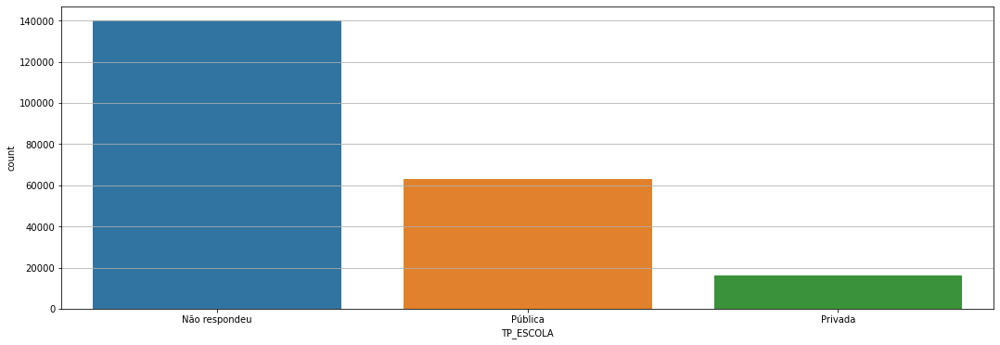

In [20]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_ESCOLA'], order=df['TP_ESCOLA'].value_counts().index)

Text(0, 0.5, 'Contagem em logaritimo')

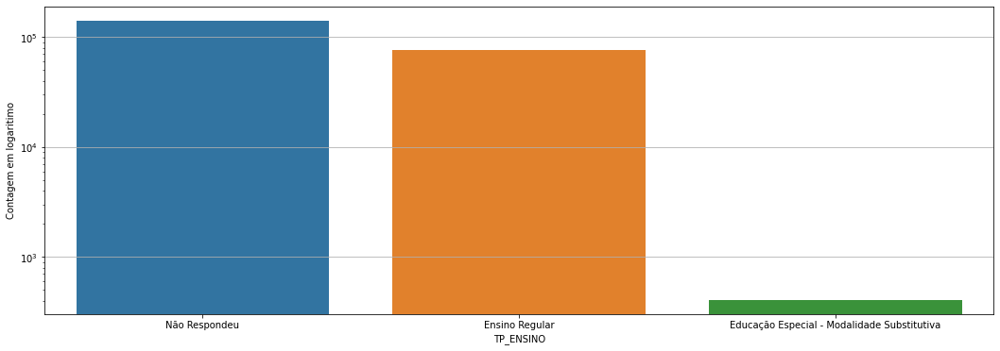

In [21]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_ENSINO'], order=df['TP_ENSINO'].value_counts().index, log=True)
ax.set_ylabel('Contagem em logaritimo')

Text(0, 0.5, 'Contagem em logaritimo')

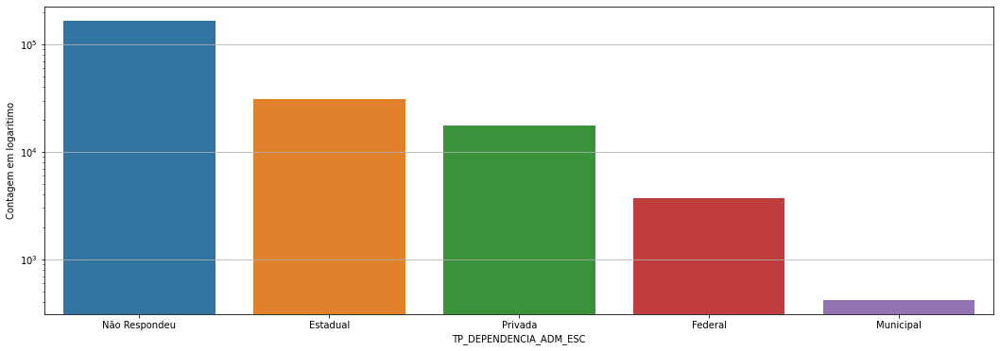

In [22]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_DEPENDENCIA_ADM_ESC'], order=df['TP_DEPENDENCIA_ADM_ESC'].value_counts().index, log=True)
ax.set_ylabel('Contagem em logaritimo')

Text(0, 0.5, 'Contagem em logaritimo')

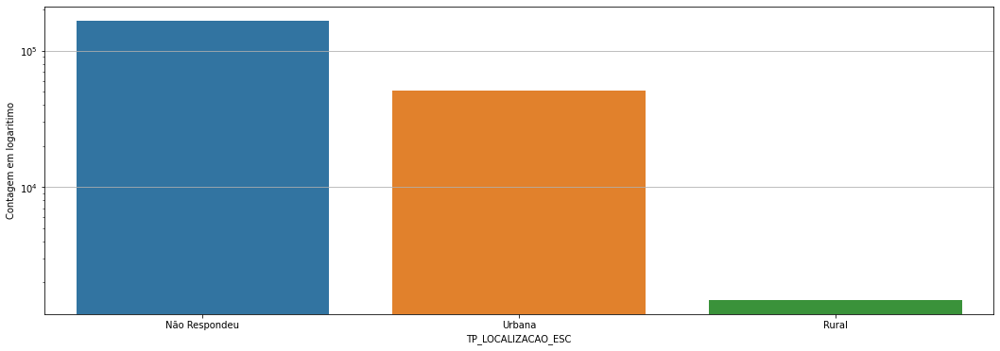

In [23]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_LOCALIZACAO_ESC'], order=df['TP_LOCALIZACAO_ESC'].value_counts().index, log=True)
ax.set_ylabel('Contagem em logaritimo')

Text(0, 0.5, 'Contagem em logaritimo')

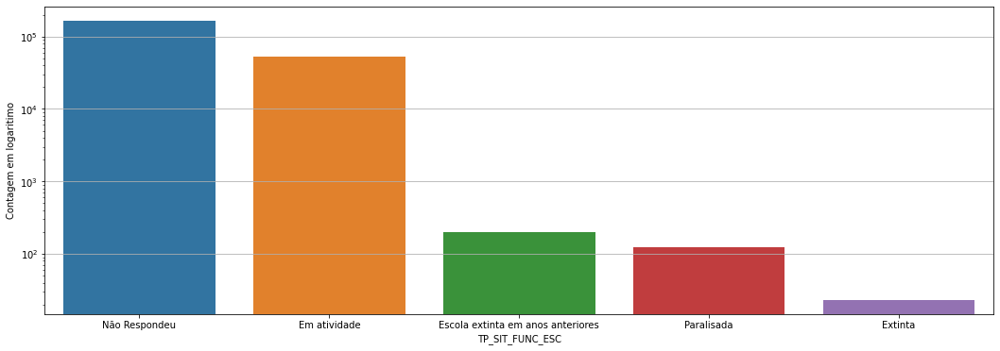

In [24]:
fig, ax = plt.subplots(figsize=(18,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_SIT_FUNC_ESC'], order=df['TP_SIT_FUNC_ESC'].value_counts().index, log=True)
ax.set_ylabel('Contagem em logaritimo')

<AxesSubplot:xlabel='TP_STATUS_REDACAO', ylabel='count'>

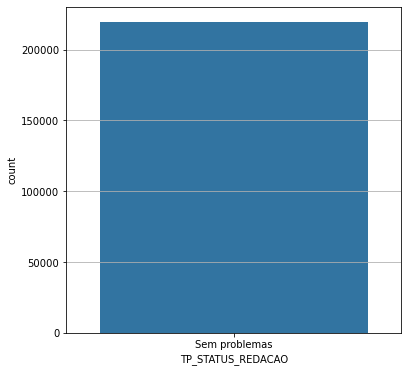

In [25]:
fig, ax = plt.subplots(figsize=(6,6)) # Criando os objetos para trabalhar com os graficos, e defindo o tamanho da figura
ax.grid(True, axis='y')
sns.countplot(x = df['TP_STATUS_REDACAO'], order=df['TP_STATUS_REDACAO'].value_counts().index)

## Criando bases, separando a base pelas regiões geográficas do Brasil

In [26]:
nordeste = separar_regiao(df, (df['SG_UF_PROVA'] == 'AL') | (df['SG_UF_PROVA'] == 'BA') | (df['SG_UF_PROVA'] == 'MA') | (df['SG_UF_PROVA'] == 'RN') | (df['SG_UF_PROVA'] == 'CE') | (df['SG_UF_PROVA'] == 'PA') | (df['SG_UF_PROVA'] == 'PI') | (df['SG_UF_PROVA'] == 'PE') | (df['SG_UF_PROVA'] == 'SE'))

In [27]:
nordeste['Região'] = 'Nordeste'

In [28]:
nordeste.head()

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025,Região
8587,2020.0,15.0,PA,1500107.0,Abaetetuba,18 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,"Completou o Ensino Médio, mas não completou a ...",Não sei,"Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 2: Diarista, empregada doméstica, cuidad...",4.0,Nenhuma renda,Não,Não,Não,Nordeste
8588,2020.0,15.0,PA,1500107.0,Abaetetuba,Menor de 17 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Não completou a 4ª série/5º ano do ensino fund...,Não completou a 4ª série/5º ano do ensino fund...,"Grupo 1: Lavrador, agricultor sem empregados, ...","Grupo 1: Lavradora, agricultora sem empregados...",3.0,"Até R$ 1.045,00",Não,Não,Não,Nordeste
8589,2020.0,15.0,PA,1500107.0,Abaetetuba,Menor de 17 anos,Feminino,Casado(a)/Mora com um(a) companheiro(a),Parda,Brasileiro(a),...,Nunca estudou,Nunca estudou,Não Sei,Não Sei,2.0,"Até R$ 1.045,00",Não,Não,Sim,Nordeste
8590,2020.0,15.0,PA,1500107.0,Abaetetuba,19 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,"Completou o Ensino Médio, mas não completou a ...","Completou a 4ª série/5º ano, mas não completou...","Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 2: Diarista, empregada doméstica, cuidad...",6.0,"De R$ 1.567,51 até R$ 2.090,00",Não,Não,Sim,Nordeste
8591,2020.0,15.0,PA,1500107.0,Abaetetuba,19 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Não completou a 4ª série/5º ano do ensino fund...,"Completou a Faculdade, mas não completou a Pós...","Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 2: Diarista, empregada doméstica, cuidad...",3.0,"De R$ 1.045,01 até R$ 1.567,50",Não,"Sim, um",Sim,Nordeste


In [29]:
nordeste.shape

(85084, 34)

In [30]:
norte = separar_regiao(df, (df['SG_UF_PROVA'] == 'AM') | (df['SG_UF_PROVA'] == 'PA') | (df['SG_UF_PROVA'] == 'AP') | (df['SG_UF_PROVA'] == 'RO') | (df['SG_UF_PROVA'] == 'RR') | (df['SG_UF_PROVA'] == 'AC') | (df['SG_UF_PROVA'] == 'TO') | (df['SG_UF_PROVA'] == 'PA'))

In [31]:
norte['Região'] = 'Norte'

In [32]:
norte.head()

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025,Região
0,2020.0,11.0,RO,1100015.0,Alta Floresta D'Oeste,23 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Não completou a 4ª série/5º ano do ensino fund...,Não completou a 4ª série/5º ano do ensino fund...,"Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 1: Lavradora, agricultora sem empregados...",4.0,"Até R$ 1.045,00",Não,Não,Sim,Norte
1,2020.0,11.0,RO,1100015.0,Alta Floresta D'Oeste,17 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a Faculdade, mas não completou a Pós...","Grupo 3: Padeiro, cozinheiro industrial ou em ...",Grupo 4: Professora (de ensino fundamental ou ...,3.0,"De R$ 2.612,51 até R$ 3.135,00",Sim,"Sim, um",Sim,Norte
2,2020.0,11.0,RO,1100015.0,Alta Floresta D'Oeste,19 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a 4ª série/5º ano, mas não completou...",Grupo 4: Professor (de ensino fundamental ou m...,"Grupo 2: Diarista, empregada doméstica, cuidad...",3.0,"De R$ 2.612,51 até R$ 3.135,00",Não,"Sim, um",Sim,Norte
3,2020.0,11.0,RO,1100015.0,Alta Floresta D'Oeste,19 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a Faculdade, mas não completou a Pós...","Grupo 2: Diarista, empregado doméstico, cuidad...",Grupo 4: Professora (de ensino fundamental ou ...,5.0,"De R$ 1.567,51 até R$ 2.090,00",Não,Não,Sim,Norte
4,2020.0,11.0,RO,1100015.0,Alta Floresta D'Oeste,Menor de 17 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a 4ª série/5º ano, mas não completou...","Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 2: Diarista, empregada doméstica, cuidad...",5.0,"De R$ 1.567,51 até R$ 2.090,00",Não,"Sim, um",Sim,Norte


In [33]:
norte.shape

(25351, 34)

In [34]:
centro_oeste = separar_regiao(df,(df['SG_UF_PROVA'] == 'GO') | (df['SG_UF_PROVA'] == 'MT') | (df['SG_UF_PROVA'] == 'MS') | (df['SG_UF_PROVA'] == 'DF'))

In [35]:
centro_oeste['Região'] = 'Centro-Oeste'

In [36]:
centro_oeste.head()

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025,Região
201372,2020.0,50.0,MS,5000203.0,Água Clara,18 anos,Masculino,Solteiro(a),Branca,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,Completou a 8ª série/9º ano do ensino fundamen...,"Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 3: Padeira, cozinheira industrial ou em ...",2.0,"De R$ 1.045,01 até R$ 1.567,50",Não,Não,Não,Centro-Oeste
201373,2020.0,50.0,MS,5000203.0,Água Clara,17 anos,Masculino,Solteiro(a),Parda,Brasileiro(a),...,Não completou a 4ª série/5º ano do ensino fund...,Completou a Pós-graduação,"Grupo 1: Lavrador, agricultor sem empregados, ...",Grupo 4: Professora (de ensino fundamental ou ...,4.0,"De R$ 3.135,01 até R$ 4.180,00",Não,"Sim, um",Sim,Centro-Oeste
201374,2020.0,50.0,MS,5000203.0,Água Clara,17 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,"Completou a 4ª série/5º ano, mas não completou...","Completou a 4ª série/5º ano, mas não completou...",Não Sei,Não Sei,5.0,"De R$ 2.090,01 até R$ 2.612,50",Não,"Sim, dois",Sim,Centro-Oeste
201375,2020.0,50.0,MS,5000203.0,Água Clara,20 anos,Masculino,Solteiro(a),Branca,Brasileiro(a),...,"Completou a 4ª série/5º ano, mas não completou...","Completou o Ensino Médio, mas não completou a ...","Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 2: Diarista, empregada doméstica, cuidad...",7.0,"De R$ 3.135,01 até R$ 4.180,00",Não,"Sim, um",Sim,Centro-Oeste
201376,2020.0,50.0,MS,5000203.0,Água Clara,23 anos,Feminino,Casado(a)/Mora com um(a) companheiro(a),Parda,Brasileiro(a),...,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ...","Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 2: Diarista, empregada doméstica, cuidad...",3.0,"De R$ 2.090,01 até R$ 2.612,50",Não,"Sim, dois",Sim,Centro-Oeste


In [37]:
sudeste = separar_regiao(df,(df['SG_UF_PROVA'] == 'SP') | (df['SG_UF_PROVA'] == 'ES') | (df['SG_UF_PROVA'] == 'RJ') | (df['SG_UF_PROVA'] == 'MG'))

In [38]:
sudeste['Região'] = 'Sudeste'

In [39]:
sudeste.head()

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025,Região
105257,2020.0,31.0,MG,3100203.0,Abaeté,18 anos,Feminino,Solteiro(a),Branca,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,"Completou a 4ª série/5º ano, mas não completou...",Não Sei,"Grupo 2: Diarista, empregada doméstica, cuidad...",5.0,"Até R$ 1.045,00",Não,Não,Não,Sudeste
105258,2020.0,31.0,MG,3100203.0,Abaeté,Menor de 17 anos,Masculino,Casado(a)/Mora com um(a) companheiro(a),Branca,Brasileiro(a),...,Completou a Pós-graduação,"Completou a Faculdade, mas não completou a Pós...","Grupo 5: Médico, engenheiro, dentista, psicólo...","Grupo 5: Médica, engenheira, dentista, psicólo...",5.0,"De R$ 3.135,01 até R$ 4.180,00",Não,"Sim, um",Sim,Sudeste
105259,2020.0,31.0,MG,3100203.0,Abaeté,18 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,"Completou a Faculdade, mas não completou a Pós...","Completou o Ensino Médio, mas não completou a ...","Grupo 1: Lavrador, agricultor sem empregados, ...","Grupo 2: Diarista, empregada doméstica, cuidad...",3.0,"De R$ 1.567,51 até R$ 2.090,00",Não,"Sim, um",Sim,Sudeste
105260,2020.0,31.0,MG,3100203.0,Abaeté,18 anos,Feminino,Solteiro(a),Branca,Brasileiro(a),...,"Completou a 4ª série/5º ano, mas não completou...","Completou o Ensino Médio, mas não completou a ...","Grupo 2: Diarista, empregado doméstico, cuidad...","Grupo 2: Diarista, empregada doméstica, cuidad...",2.0,"Até R$ 1.045,00",Não,Não,Sim,Sudeste
105261,2020.0,31.0,MG,3100203.0,Abaeté,17 anos,Feminino,Solteiro(a),Branca,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,Completou a 8ª série/9º ano do ensino fundamen...,"Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 3: Padeira, cozinheira industrial ou em ...",2.0,"De R$ 1.567,51 até R$ 2.090,00",Não,"Sim, um",Sim,Sudeste


In [40]:
sudeste.shape

(72092, 34)

In [41]:
sul=separar_regiao(df,(df['SG_UF_PROVA'] == 'SC') | (df['SG_UF_PROVA'] == 'PR') | (df['SG_UF_PROVA'] == 'RS'))

In [42]:
sul['Região'] = 'Sul'

In [43]:
sul.head()

,NU_ANO,CO_UF_PROVA,SG_UF_PROVA,CO_MUNICIPIO_PROVA,NO_MUNICIPIO_PROVA,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,...,Q001,Q002,Q003,Q004,Q005,Q006,Q023,Q024,Q025,Região
178493,2020.0,41.0,PR,4100400.0,Almirante Tamandaré,21 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Não completou a 4ª série/5º ano do ensino fund...,"Completou o Ensino Médio, mas não completou a ...","Grupo 3: Padeiro, cozinheiro industrial ou em ...",Grupo 4: Professora (de ensino fundamental ou ...,5.0,"De R$ 2.612,51 até R$ 3.135,00",Sim,"Sim, um",Sim,Sul
178494,2020.0,41.0,PR,4100400.0,Almirante Tamandaré,19 anos,Masculino,Solteiro(a),Branca,Brasileiro(a),...,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ...","Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 2: Diarista, empregada doméstica, cuidad...",5.0,"De R$ 2.612,51 até R$ 3.135,00",Não,"Sim, dois",Sim,Sul
178495,2020.0,41.0,PR,4100400.0,Almirante Tamandaré,18 anos,Feminino,Solteiro(a),Branca,Brasileiro(a),...,"Completou o Ensino Médio, mas não completou a ...",Completou a Pós-graduação,"Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 2: Diarista, empregada doméstica, cuidad...",2.0,"De R$ 1.567,51 até R$ 2.090,00",Sim,"Sim, um",Sim,Sul
178496,2020.0,41.0,PR,4100400.0,Almirante Tamandaré,17 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,"Completou o Ensino Médio, mas não completou a ...","Completou a 4ª série/5º ano, mas não completou...",Grupo 4: Professor (de ensino fundamental ou m...,"Grupo 2: Diarista, empregada doméstica, cuidad...",4.0,"De R$ 3.135,01 até R$ 4.180,00",Sim,"Sim, três",Sim,Sul
178497,2020.0,41.0,PR,4100400.0,Almirante Tamandaré,18 anos,Feminino,Solteiro(a),Parda,Brasileiro(a),...,Completou a 8ª série/9º ano do ensino fundamen...,Não completou a 4ª série/5º ano do ensino fund...,"Grupo 3: Padeiro, cozinheiro industrial ou em ...","Grupo 2: Diarista, empregada doméstica, cuidad...",3.0,"De R$ 1.045,01 até R$ 1.567,50",Não,Não,Sim,Sul


In [44]:
sul.shape

(22545, 34)

## Explorando a Região Nordeste

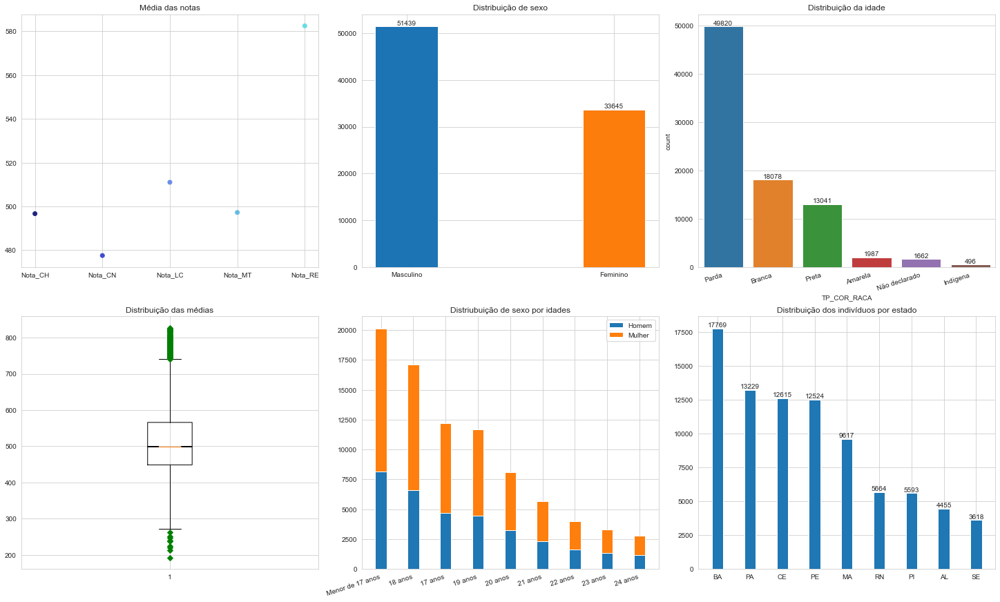

In [45]:
graficos_padrao(nordeste)

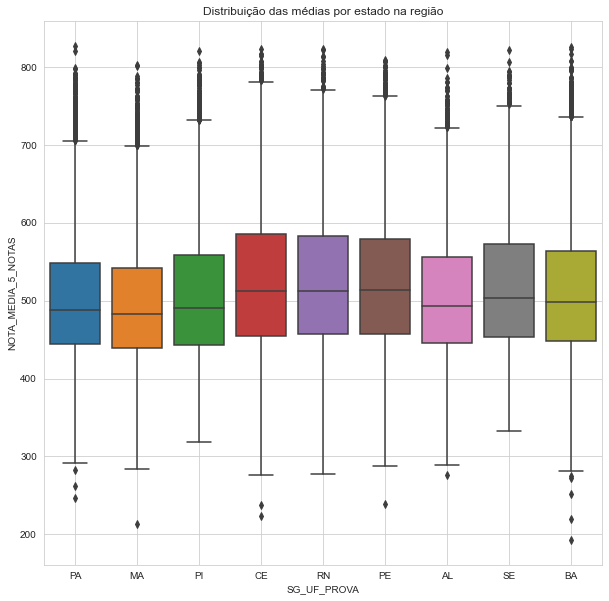

In [82]:
distribuir_notas(nordeste, 10)

## Explorando a Região Norte

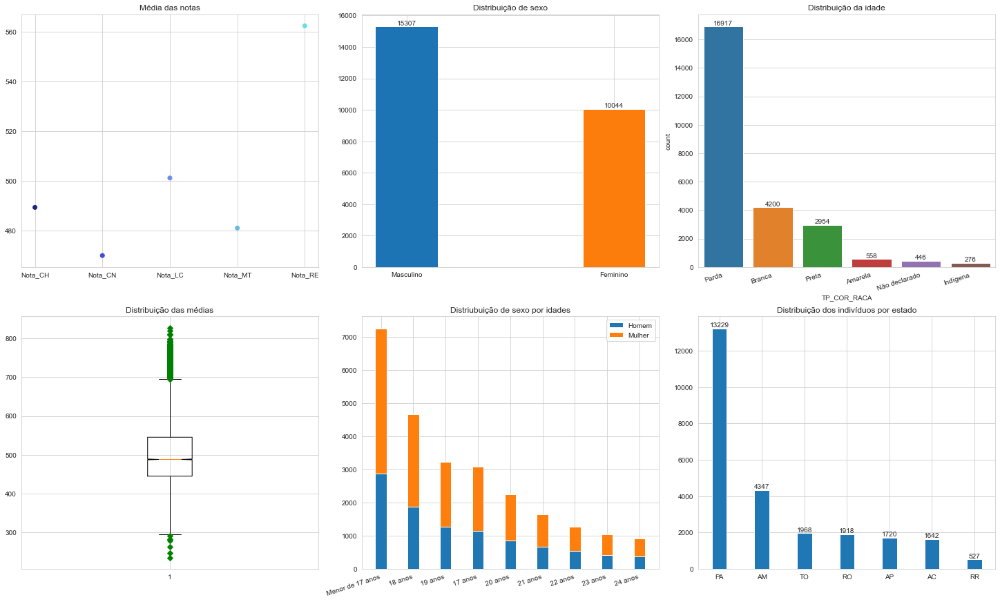

In [47]:
graficos_padrao(norte)

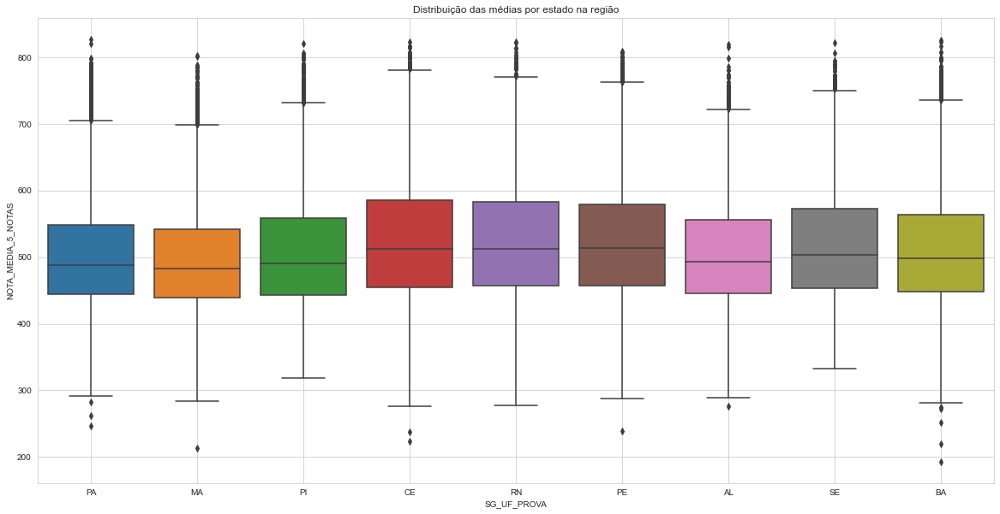

In [83]:
distribuir_notas(nordeste, 20)

## Explorando Região Centro-Oeste

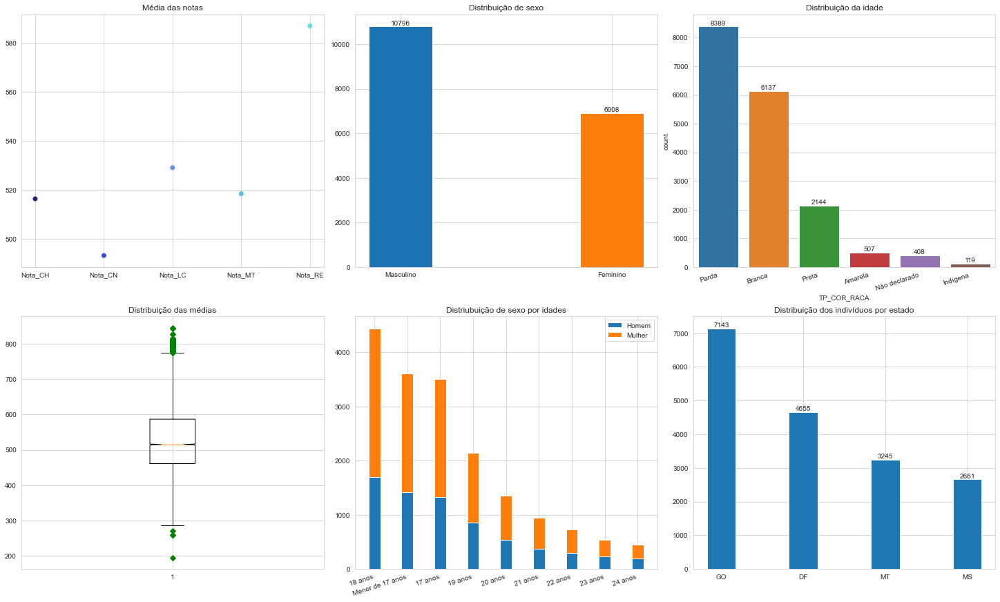

In [49]:
graficos_padrao(centro_oeste)

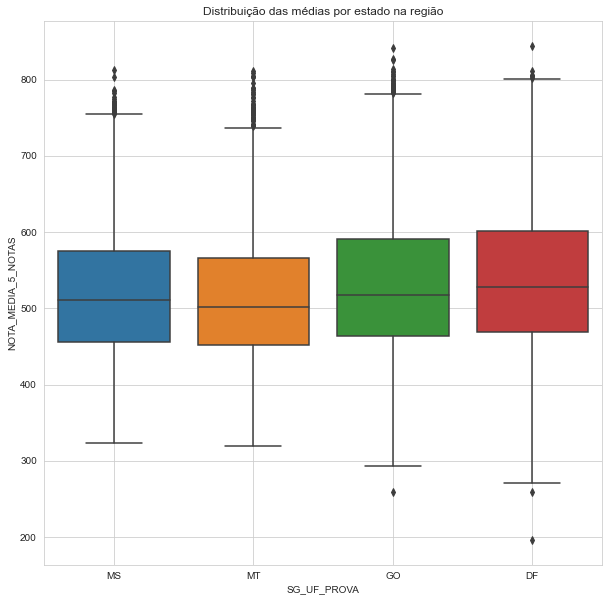

In [84]:
distribuir_notas(centro_oeste, 10)

## Explorando Região Sul

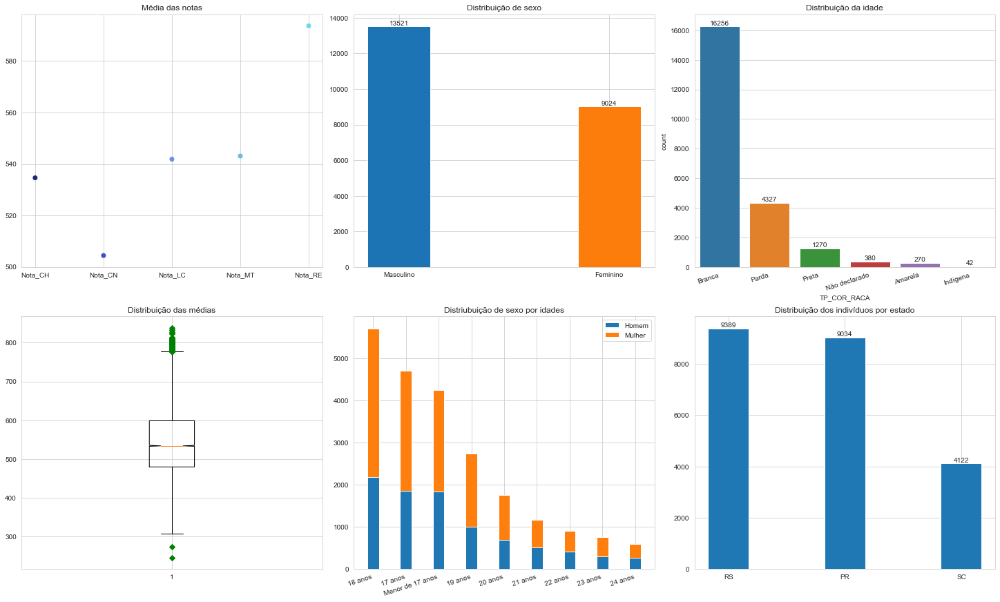

In [51]:
graficos_padrao(sul)

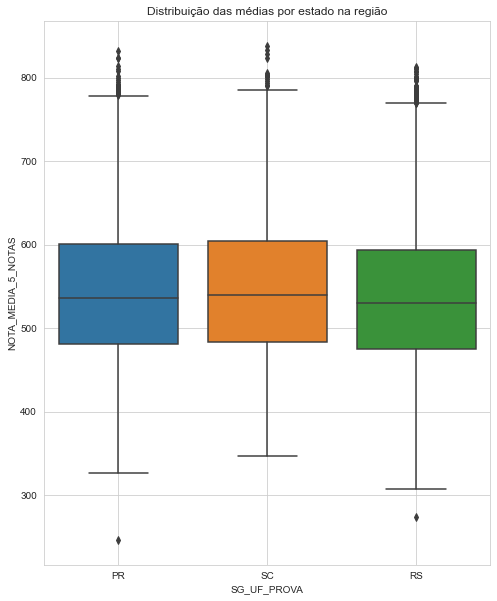

In [85]:
distribuir_notas(sul, 8)

## Explorando Região Sudoeste

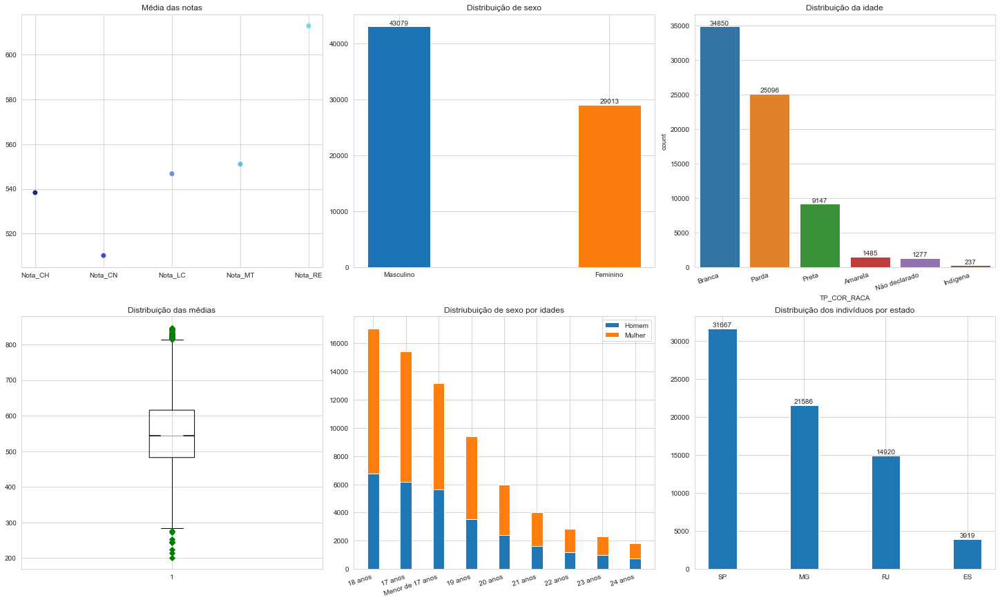

In [53]:
graficos_padrao(sudeste)

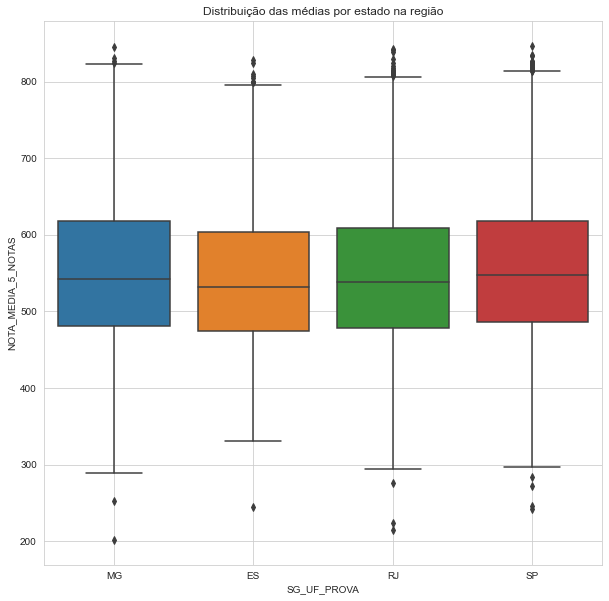

In [86]:
distribuir_notas(sudeste, 10)

## Explorando as notas da base

In [55]:
cdf = pd.concat([nordeste, sudeste, sul, norte, centro_oeste])  

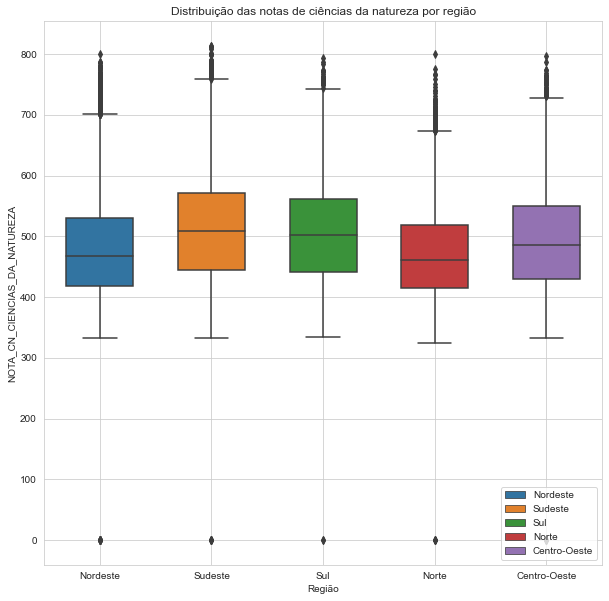

In [68]:
ax = fazer_boxplot(cdf, 'NOTA_CN_CIENCIAS_DA_NATUREZA')
ax.set_title('Distribuição das notas de ciências da natureza por região')
ax.legend(loc='lower right')

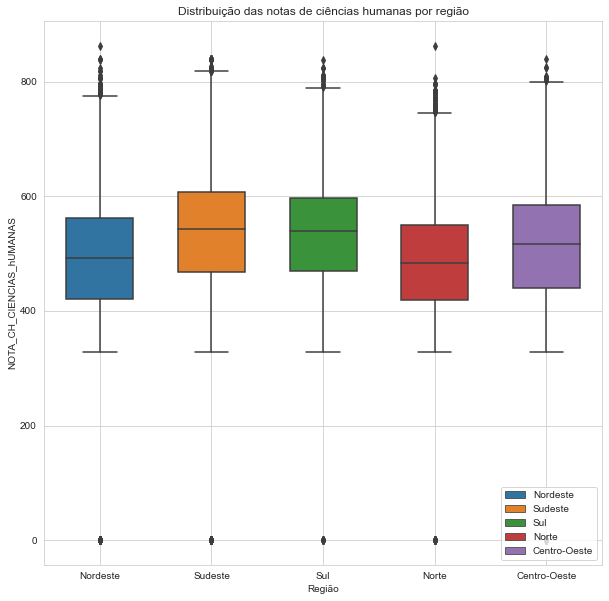

In [69]:
ax = fazer_boxplot(cdf, 'NOTA_CH_CIENCIAS_hUMANAS')
ax.set_title('Distribuição das notas de ciências humanas por região')
ax.legend(loc='lower right')

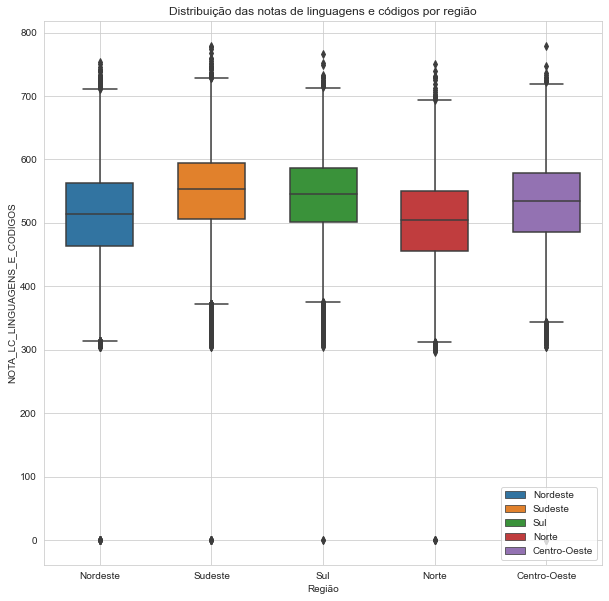

In [70]:
ax = fazer_boxplot(cdf, 'NOTA_LC_LINGUAGENS_E_CODIGOS')
ax.set_title('Distribuição das notas de linguagens e códigos por região')
ax.legend(loc='lower right')

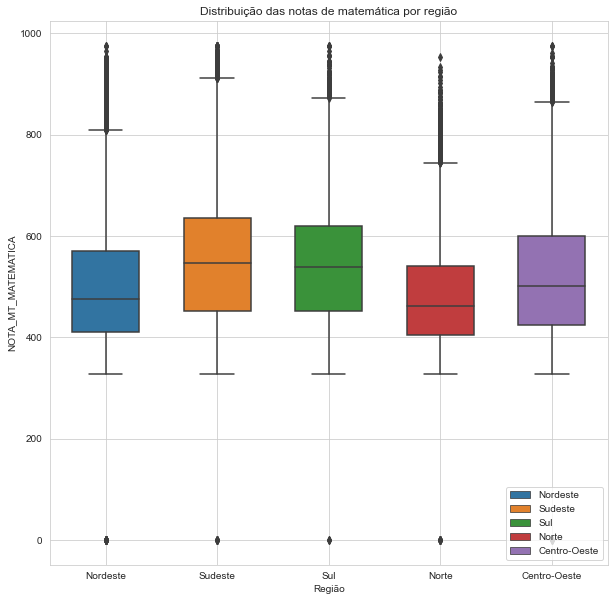

In [71]:
ax = fazer_boxplot(cdf, 'NOTA_MT_MATEMATICA')
ax.set_title('Distribuição das notas de matemática por região')
ax.legend(loc='lower right')

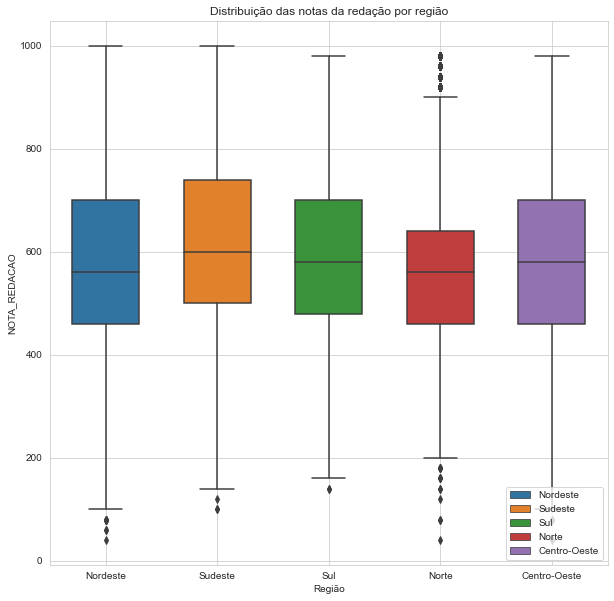

In [72]:
ax = fazer_boxplot(cdf, 'NOTA_REDACAO')
ax.set_title('Distribuição das notas da redação por região')
ax.legend(loc='lower right')

In [73]:
import plotly.express as px
fig = px.box(cdf, x='Região', y='NOTA_MEDIA_5_NOTAS', facet_col_spacing=0.3,facet_row_spacing=0.3, color="Região", animation_group='Região')
fig.show()

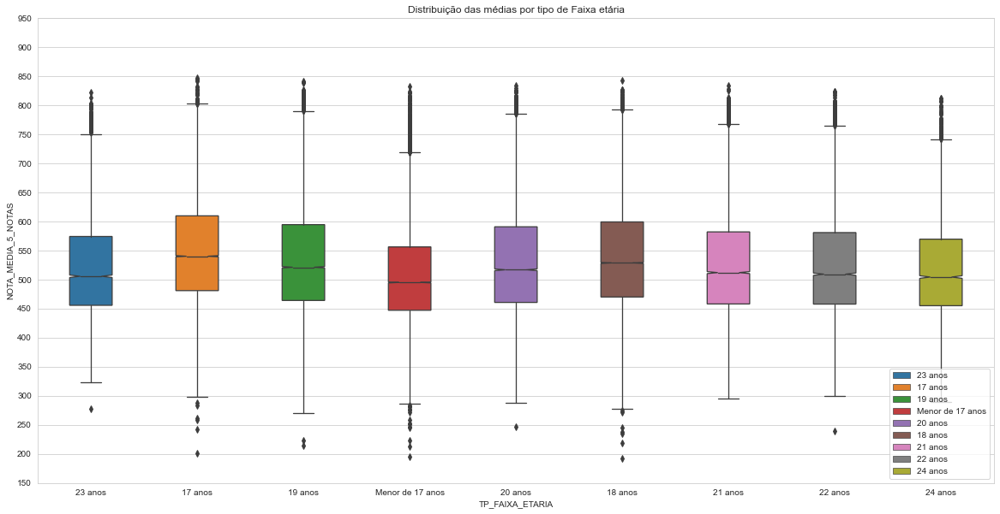

In [74]:
fig, ax = plt.subplots(figsize=(20, 10))
ax.grid(True, which='major')
sns.boxplot(x='TP_FAIXA_ETARIA', y='NOTA_MEDIA_5_NOTAS', data=df, hue='TP_FAIXA_ETARIA',linewidth=1.3, notch=True, dodge=False, width=0.4)
ax.set_title('Distribuição das médias por tipo de Faixa etária')
plt.yticks(np.arange(150, 1000, 50))
ax.legend(loc='lower right')

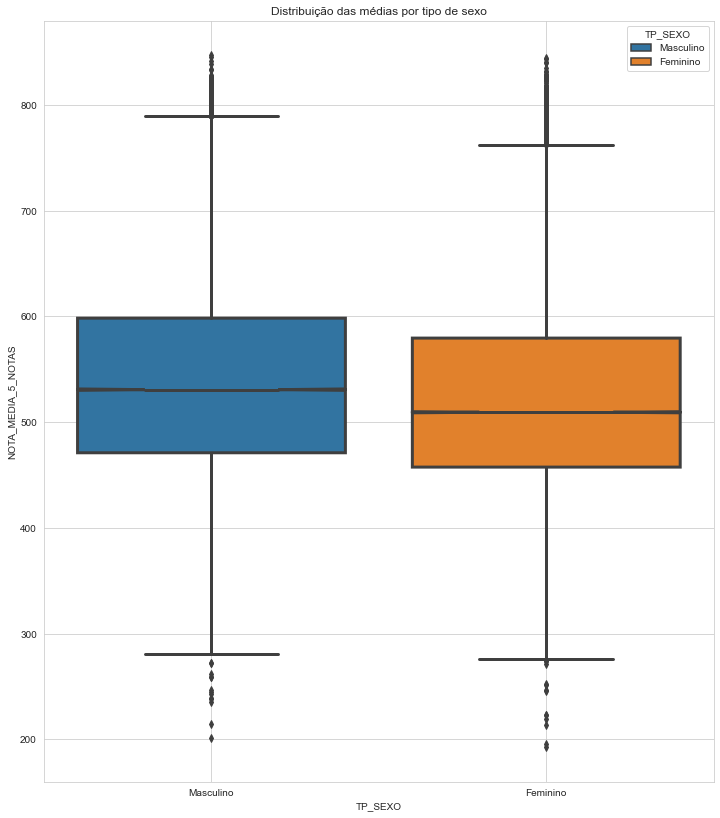

In [75]:
fig, ax = plt.subplots(figsize=(12, 14))
sns.boxplot(x='TP_SEXO', y='NOTA_MEDIA_5_NOTAS', data=df, hue='TP_SEXO',linewidth=3, notch=True, dodge=False)
ax.set_title('Distribuição das médias por tipo de sexo')
ax.grid(True)

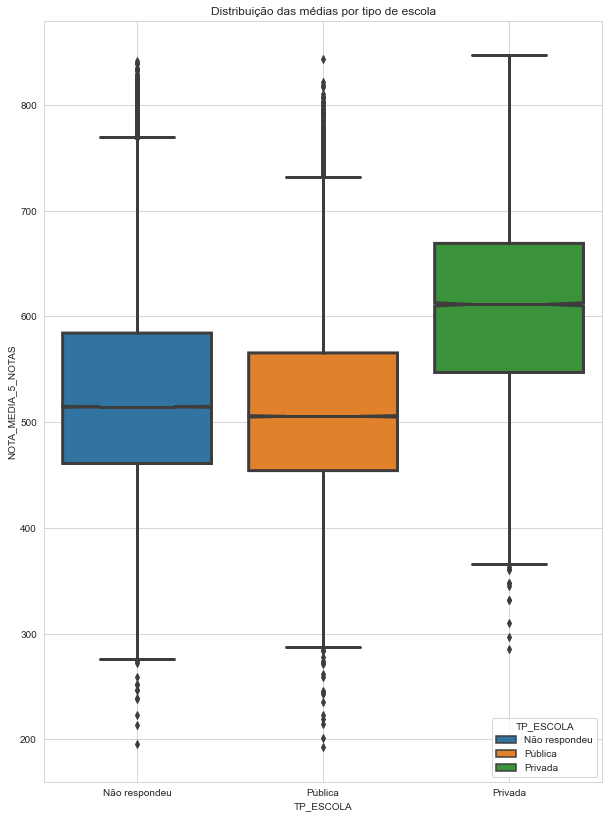

In [76]:
fig, ax = plt.subplots(figsize=(10, 14))
sns.boxplot(x='TP_ESCOLA', y='NOTA_MEDIA_5_NOTAS', data=df, hue='TP_ESCOLA',linewidth=3, notch=True, dodge=False)
ax.set_title('Distribuição das médias por tipo de escola')
ax.grid(True)

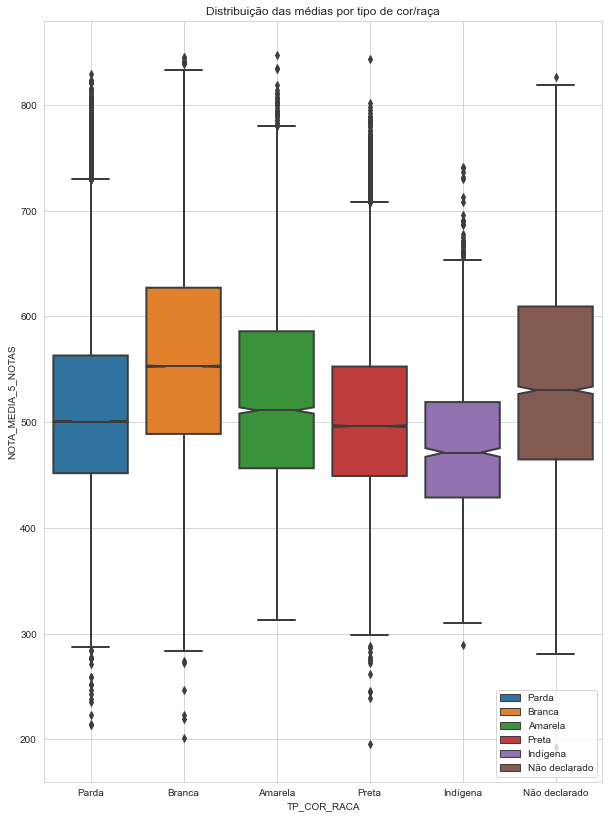

In [77]:
fig, ax = plt.subplots(figsize=(10, 14))
sns.boxplot(x='TP_COR_RACA', y='NOTA_MEDIA_5_NOTAS', data=df, hue='TP_COR_RACA',linewidth=2, notch=True, dodge=False)
ax.set_title('Distribuição das médias por tipo de cor/raça')
ax.grid(True)
ax.legend(loc='lower right')

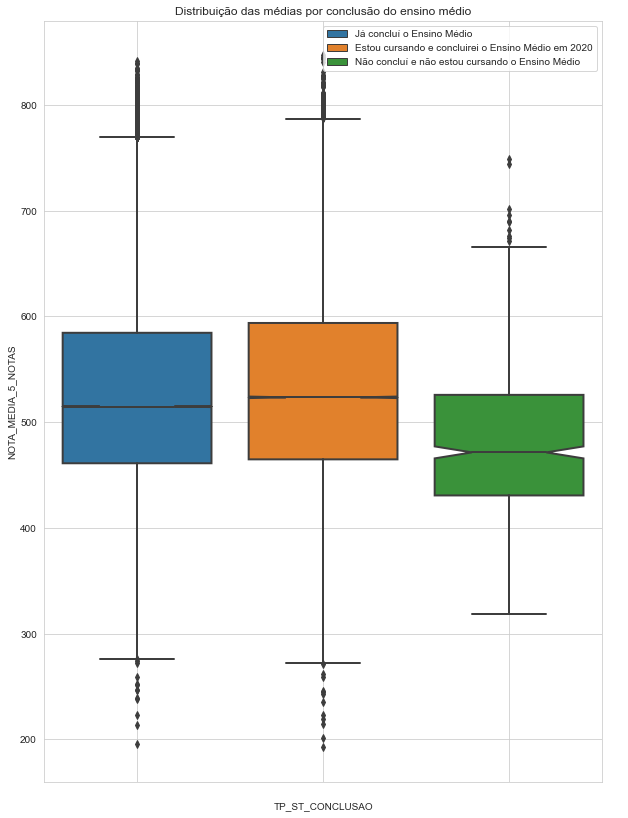

In [78]:
fig, ax = plt.subplots(figsize=(10, 14))
sns.boxplot(x='TP_ST_CONCLUSAO', y='NOTA_MEDIA_5_NOTAS', data=df, hue='TP_ST_CONCLUSAO',linewidth=2, notch=True, dodge=False)
ax.set_title('Distribuição das médias por conclusão do ensino médio')
plt.xticks(color='w')
ax.grid(True)
ax.legend(loc='upper right')

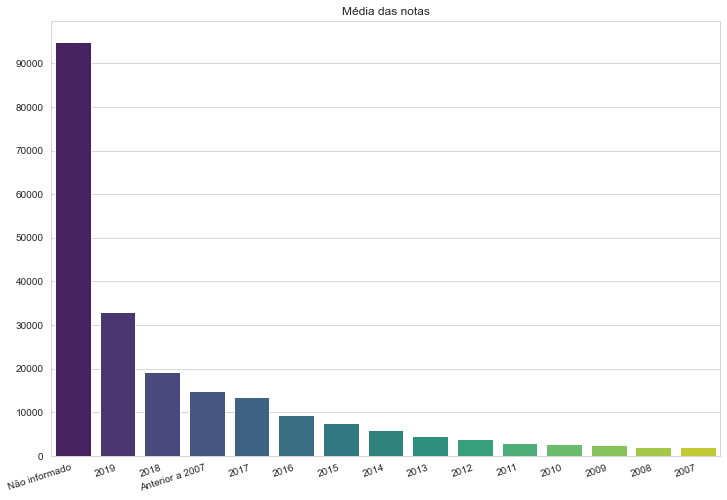

In [67]:
fig, ax = plt.subplots(figsize=(12,8))
ax = sns.barplot(x=df.TP_ANO_CONCLUIU.value_counts().index, y=df["TP_ANO_CONCLUIU"].value_counts().values, ax=ax, palette='viridis', )
plt.setp(ax.get_xticklabels(), rotation=18, ha="right")
plt.yticks(np.arange(0, df.TP_ANO_CONCLUIU.value_counts().max(), 10000))
ax.set_title('Média das notas')
ax.grid(True,  axis='y')